## SOLO
In this assignment, we are only providing the barest templates for your code structure. If you prefer, you can write and debug most of the components in a regular python and only use Jupyter to train. In this case, you might have several files that you import into this notebook, e.g.
* `dataset.py`
* `model.py`

This is shown below. All files should be included in your submission.

In [1]:
try:
    import dataset
    import model
except ModuleNotFoundError:
    pass

In [2]:
!pip install pytorch-lightning
!pip install torchtext

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 727.7/727.7 kB 7.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 805.2/805.2 kB 13.7 MB/s eta 0:00:00


## Overview

Instance segmentation can be thought of as a combination of object detection and semantic segmentation, the former of which you already explored in the previous project. A visulization of this relationship can be seen in fig. 1.

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig1.png" width=500/></div>
<center>Figure 1: An overview of instance segmentation.</center>  

In this project, you are tasked with implementing an instance segmentation framework know as SOLO (Segmenting Object by LOcations). In a similar manner to YOLO, SOLO produces mask predictions on a dense grid. This means that, unlike many other segmenation frameworks (e.g. Mask-RCNN), SOLO directly predicts the segmentation mask without proposing bounding box locations. An visual summary of SOLO can be seen in fig. 2 and 3.

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig2.png" width=200/></div>
<center>Figure 2: SOLO.</center>  

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig3.png" width=600/></div>
<center>Figure 3: SOLO branches.</center>

These dense predictions are produced at several different scales using a Feature Pyramid Network (FPN). Using the last few layers of the backbone, we pass the higher level features from the deeper layers back up to larger features scales using lateral connections, shown in fig. 4. The integration of the FPN into your network will be the primary focus of this project.

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig4.png" width=300/></div>
<center>Figure 4: SOLO branches.</center>

## Part A

### Dataset
#### Dataset Structure
The dataset used in this project contains three classes across 3265 images: vehicles, people, and animals. The dataset contains the following elements:

* A numpy array of images ($3 \times 300 \times 400$).
* A numpy array of masks ($300 \times 400$).
* A list of ground truth labels by image.
* A list of bounding boxes by image.

Note that the mask array is flattened; to determine which masks belong to which image, count the number of labels associated with that image. For example, if the first few images have 3, 2, and 4 labels, masks 0-2 would belong to image 1, masks 3-4 would belong to image 2, etc. The masks are ordered correctly to allow for this. You can find the dataset set here: https://drive.google.com/drive/folders/1eP7FtPaWfJ5zLdcsZYl6eyn5EYixkFn8

#### Loading and Batching
You should apply the following transformations to each image:
* Normalize pixel values to $[0,1]$.
* Rescale the image to $800 \times 1066$.
* Normalize each channel with means $[0.485, 0.456, 0.406]$ and standard deviations $[0.229, 0.224, 0.225]$.
* Zero pad the image to $800 \times 1088$.

Since each image will have a different number of objects, you will have to write your own collation function to properly batch the images. An example collate_fn is shown below, along with expected output dimensions.

In [3]:
# download data, you can maunally download dataset set here:
# https://drive.google.com/drive/folders/1eP7FtPaWfJ5zLdcsZYl6eyn5EYixkFn8

!gdown --id 1JD3OaHpq_4KCb7ofcPMkknmdEXFHrCcn
!gdown --id 1ssRA7yijGLFmJU-ac-lPyUOq7DYzTAS1
!gdown --id 1Rpz-ZuQxDwvLyzc0FD9GZxAKlyka3VC5
!gdown --id 1ouMFNT1thia8l6P5vcWCY-nweAexLDsB
%pip install pytorch-lightning

/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1JD3OaHpq_4KCb7ofcPMkknmdEXFHrCcn
To: /content/hw3_mycocodata_mask_comp_zlib.h5
100% 4.30M/4.30M [00:00<00:00, 26.0MB/s]
/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1ssRA7yijGLFmJU-ac-lPyUOq7DYzTAS1
To: /content/hw3_mycocodata_labels_comp_zlib.npy
100% 269k/269k [00:00<00:00, 3.64MB/s]
/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downl

In [4]:
import os

#set the working directory

root_dir = "/content/"

#choose the project folder
project_folder = ""

#define a function to create and set the working directory
def create_and_set_working_directory(project_folder):
  #check if the project folder exists. if not, make one.
  if os.path.isdir(root_dir + project_folder) == False:
    os.mkdir(root_dir + project_folder)
    print(root_dir + project_folder + 'did not existed and was created.')

  #change the OS path to project folder as working directory
  os.chdir(root_dir + project_folder)

  #create a test file in the working directory and see if it shows up at the right place
  !touch 'new_file_test.txt'
  print('working directory' + root_dir + project_folder + \
        "empty text file created. You can also run !pwd command to confirm working directory.")

create_and_set_working_directory(project_folder)

working directory/content/empty text file created. You can also run !pwd command to confirm working directory.


In [5]:
# images:         (batch_size, 3, 800, 1088)
# labels:         list with len: batch_size, each (n_obj,)
# masks:          list with len: batch_size, each (n_obj, 800,1088)
# bounding_boxes: list with len: batch_size, each (n_obj, 4)
!pip install pytorch-lightning
import os
import numpy as np
from scipy import ndimage

import torch
import torchvision
from torchvision import transforms, datasets
from torch import nn, optim
from matplotlib import pyplot as plt
from torch.utils import data
from torch.utils.data import DataLoader
import torch.nn.functional as F
import pytorch_lightning as pl
import pytorch_lightning.loggers as pl_loggers
import pytorch_lightning.callbacks as pl_callbacks

import pickle
import h5py
#import helpers

import cv2
from PIL import Image
from pathlib import Path
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from sklearn.model_selection import train_test_split
import xml.etree.ElementTree as ET

In [8]:

print(os.getcwd())

def load_data_h5(file_name):
  value = h5py.File(file_name)
  value_1 = value.get('data')
  ds = np.array(value_1)
  print(type(value))
  print(type(ds))
  # value = np.array(hf['data'][:])
  #hf = h5py.File('path/to/file.h5', 'r')
  #n1 = np.array(hf["dataset_name"][:]) #dataset_name is same as hdf5 object name
  del value,value_1
  return ds

def load_data_np(file_name):
  data = np.array(np.load(file_name, allow_pickle=True))
  return data

paths = ['/content/hw3_mycocodata_mask_comp_zlib.h5','/content/hw3_mycocodata_img_comp_zlib.h5','/content/hw3_mycocodata_labels_comp_zlib.npy','/content/hw3_mycocodata_bboxes_comp_zlib.npy']


/content


In [ ]:
class SOLODataset(data.Dataset):
  def __init__ (self, path):
    self.masks = h5py.File(path[0])['data']
    self.img = h5py.File(path[1])['data']
    self.lab = np.array(np.load(path[2], allow_pickle=True))
    self.bbox =  np.array(np.load(path[3],allow_pickle=True))

    self.transform = transforms.Compose([
         transforms.Resize((800, 1066)),
         transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
         transforms.Pad((11,0))])
    self.transform_mask = transforms.Compose([
         transforms.Resize((800, 1066)),
         transforms.Pad((11,0))])
  def __len__(self):
        return len(self.img)

  def __getitem__(self, idx):
    mask_numb = 0
    mask_numb_end = 0

    for i in range(idx):
        mask_numb+=len(self.lab[i])
    mask_numb_end = mask_numb + len(self.lab[idx])

    img = self.transform(torch.tensor(self.img[idx]/255,dtype=torch.float32))
    masks = self.transform_mask(torch.tensor(self.masks[mask_numb:mask_numb_end]/1.0,dtype=torch.int32))
    bbox = self.bbox[idx]*2.667# Rescaling the bounding boxes
    bbox[:,[1,3]] += 11
    sample = img,self.lab[idx],masks,bbox

    return sample

# smaller data set for visulaising
image_ds = SOLODataset(paths)

first_data = image_ds[81]
imgs,lbls,msks,bbs = first_data


In [10]:
def collate_fn(batch):
  image_list =[]
  label_list = []
  masks_list = []
  bounding_boxes_list = []

  for images,labels,masks,boxes in batch:
    image_list.append(images)
    label_list.append(labels)
    masks_list.append(masks)
    bounding_boxes_list.append(boxes)

  return torch.stack(image_list,dim = 0), label_list, masks_list, bounding_boxes_list

small_ds = 100
split = len(image_ds) - small_ds
torch.random.manual_seed(1)

# batch size =5 ( crashes for bigger batch sizes)
image_ds_small,_  = torch.utils.data.random_split(image_ds, [small_ds, split])

dataloader = DataLoader(image_ds, batch_size=5,shuffle=True, collate_fn=collate_fn)
images, labels, masks, bboxes = next(iter(dataloader))

#### Visualization
In order to validate that you are loading the dataset correct, you should plot at least five example images that include the mask, annotations, and bounding boxes. Examples of such images are shown in fig. 5 and 6. Make sure that the color for each class is consistent!

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig5.png" width=500/></div>
<center>Figure 5: Example visualization.</center>

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig6.png" width=500/></div>
<center>Figure 6: Example visualization.</center>

1


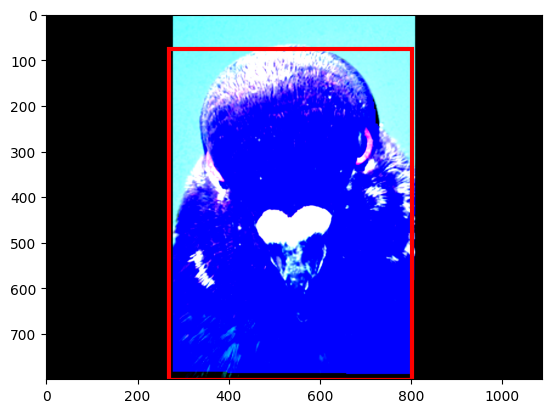

1


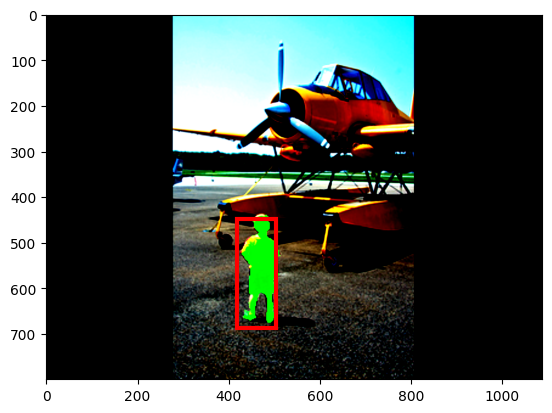

2


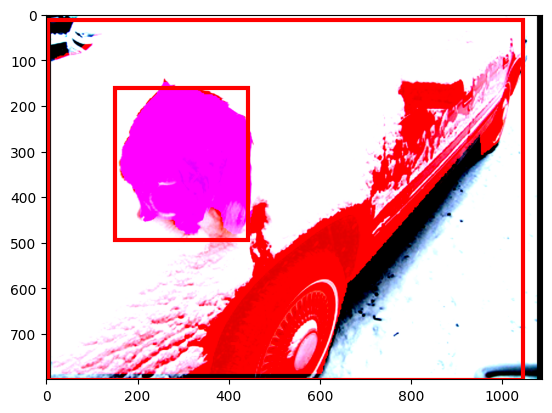

1


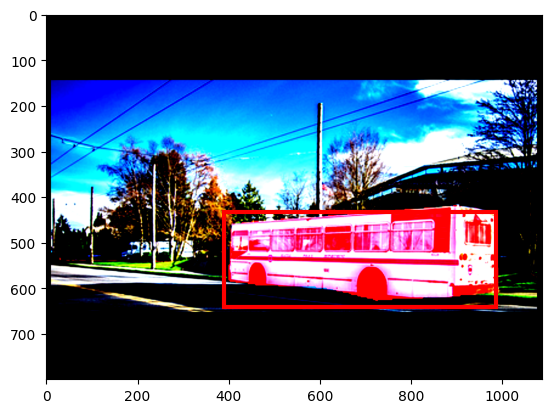

2


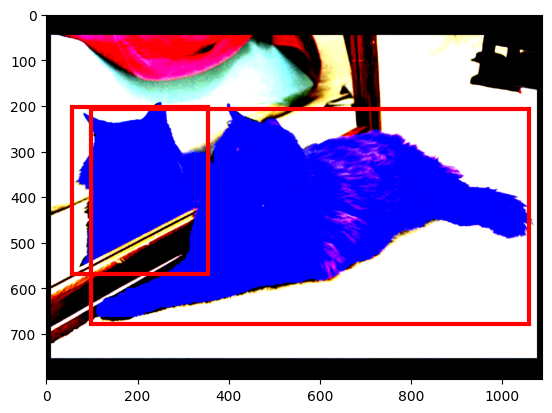

1


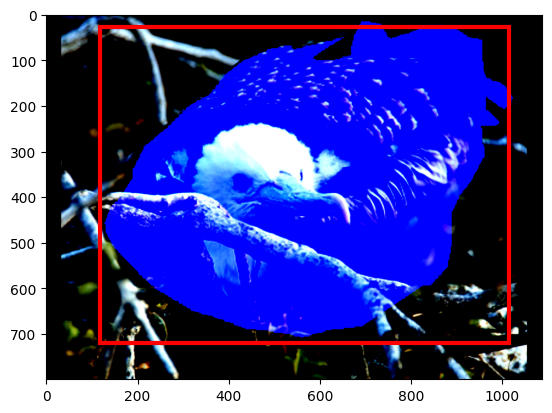

1


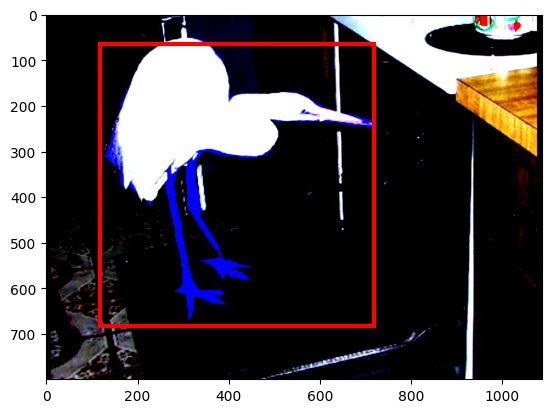

2


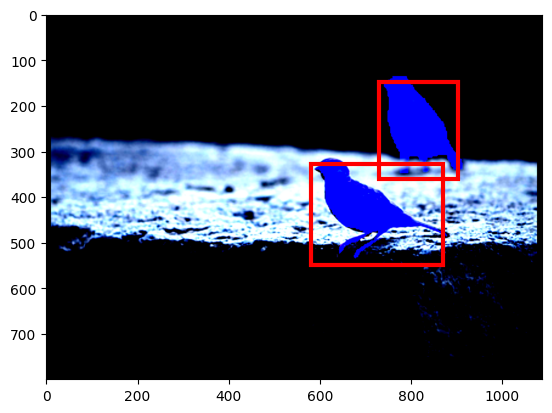

1


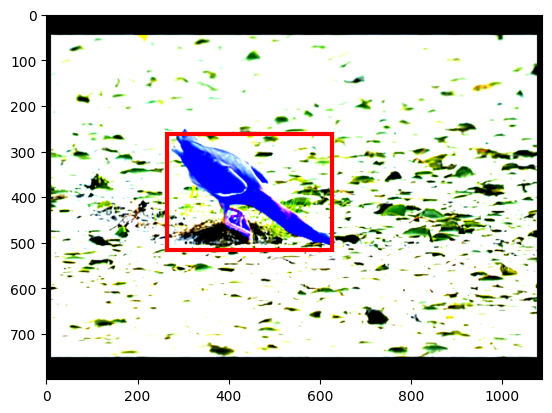

1


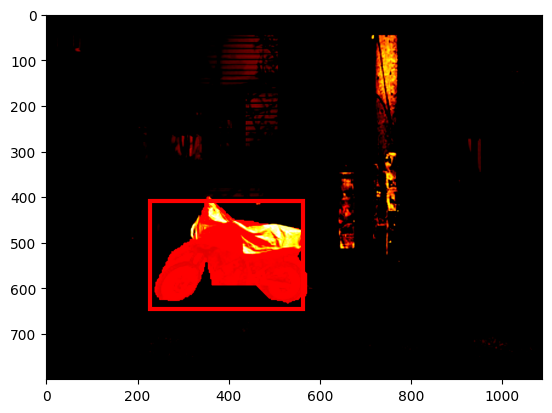

In [11]:
# Show the chosen image with ground truth bounding boxes visualized.
from matplotlib.patches import Rectangle


def visualise_labels(images, labels, masks, bboxes ):
  for img,lbl,msk,bbx in zip(images, labels, masks, bboxes):

      plt.figure()
      plt.axes()

      plot=img.numpy()
      plot= np.moveaxis(plot,0,-1)
      print(len(lbl))
      for i in range(len(lbl)):
          show_mask= msk[i].numpy()
          if lbl[i]==0:
            pass
          if lbl[i]==1:
              plot[:,:,0] += show_mask*3
          if lbl[i]==2:
              plot[:,:,1] += show_mask*3
          if lbl[i]==3:
              plot[:,:,2] += show_mask*3

      plt.imshow(np.clip(plot,0,1))

      for i in range(len(bbx)):
          rectangle = plt.Rectangle((bbx[i][0],bbx[i][1]), bbx[i][2]-bbx[i][0],bbx[i][3]-bbx[i][1],fill=False, ec='r', lw=3)
          plt.gca().add_patch(rectangle)

      plt.show()
dataloader = DataLoader(image_ds, batch_size=10,shuffle=True, collate_fn=collate_fn)
images, labels, masks, bboxes = next(iter(dataloader))
visualise_labels(images, labels, masks, bboxes )

### Model
#### Architecture
The model architecture is summarized in fig. 7 and tables 1 and 2.

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig7.png" width=500/></div>
<center>Figure 7: SOLO branch structure.</center>
<br>
<center>Table 1: Category branch structure.</center>

| Layer | Hyperparameters |
| :--- | :--- |
| conv1 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv2 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv3 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv4 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv5 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv6 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv7 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv_out | Kernel size $= 3\times3\times(C-1)$, stride $= 1$, pad $= 1$, bias $= \text{True}$. <br> Followed by Sigmoid layer. Note $C = 4$ here (number of classes + background). |

<br>
<center>Table 2: Mask branch structure.</center>

| Layer | Hyperparameters |
| :--- | :--- |
| conv1 | Kernel size $= 3\times3\times(256 + 2)$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Two additional input channels represent the $x$ and $y$ positional encoding. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv2 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv3 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv4 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv5 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv6 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv7 | Kernel size $= 3\times3\times256$, stride $= 1$, pad $= 1$, bias $= \text{False}$. <br> Followed by GroupNorm, num_groups $=32$ and ReLU |
| conv_out | Kernel size $= 1\times1\times(\text{num_grid})^2$, stride $= 1$, pad $= 0$, bias $= \text{True}$. <br> Followed by Sigmoid layer. Note that $\text{num_grid}$ is different for each layer of the FPN. |

We will be using a pretrained backbone (which includes an FPN), so you will not have to implement those components. A template for the network with along with default parameters is shown below.

#### Feature Pyramid
The feature pyramid extracted below has strides $[4,8,16,32,64]$ over the original image. To match the SOLO paper, this should be interpolated to have strides $[8,8,16,32,32]$.

#### Target Assignment
Some notes about generating the ground truth targets:
* The FPN levels can be though of as different grid sizes cut through the image.
* You assign each target to a certain FPN level if $\sqrt{wh}$ from the bounding box falls within the `scale_range` associated with that level. Note that these overlap, so you may assign the same target to multiple levels.
* A grid cell should be considered as predicting an object if that grid cell falls into the "centre region" of the object.
 * The centre region of an object is its bounding box scaled by `epsilon`.
 * Each grid cell can predict at most one object, but each object can be predicted by more than one grid cell.

#### Target Visualization
You should produce visualizations such as fig. 8 and 9 to validate your target assignments.

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig8.png" width=500/></div>
<center>Figure 8: Target assignment example.</center>

<div><img src="https://github.com/LukasZhornyak/CIS680_files/raw/main/HW3/fig9.png" width=500/></div>
<center>Figure 9: Target assignment example.</center>

In [12]:
import pytorch_lightning as pl

class SOLO(pl.LightningModule):
    _default_cfg = {
        'num_classes': 4,
        'in_channels': 256,
        'seg_feat_channels': 256,
        'stacked_convs': 7,
        'strides': [8, 8, 16, 32, 32],
        'scale_ranges': [(1, 96), (48, 192), (96, 384), (192, 768), (384, 2048)],
        'epsilon': 0.2,
        'num_grids': [40, 36, 24, 16, 12],
        'mask_loss_cfg': dict(weight=3),
        'cate_loss_cfg': dict(gamma=2, alpha=0.25, weight=1),
        'postprocess_cfg': dict(cate_thresh=0.2, mask_thresh=0.5, pre_NMS_num=50, keep_instance=5, IoU_thresh=0.5)
    }

    def __init__(self, **kwargs):
        super().__init__()
        for k, v in {**self._default_cfg, **kwargs}.items():
            setattr(self, k, v)

        pretrained_model = torchvision.models.detection.maskrcnn_resnet50_fpn(pretrained=False, pretrained_backbone=True)
        self.backbone = pretrained_model.backbone
        self.num_training_steps = 0

        self.cat_seq = nn.Sequential(
          nn.Conv2d(256, 256, (3, 3), stride=1, padding=1, bias=False),
          nn.GroupNorm(32, 256),
          nn.ReLU(),
          nn.Conv2d(256, 256, (3, 3), stride=1, padding=1, bias=False),
          nn.GroupNorm(32, 256),
          nn.ReLU(),
          nn.Conv2d(256, 256, (3, 3), stride=1, padding=1, bias=False),
          nn.GroupNorm(32, 256),
          nn.ReLU(),
          nn.Conv2d(256, 256, (3, 3), stride=1, padding=1, bias=False),
          nn.GroupNorm(32, 256),
          nn.ReLU(),
          nn.Conv2d(256, 256, (3, 3), stride=1, padding=1, bias=False),
          nn.GroupNorm(32, 256),
          nn.ReLU(),
          nn.Conv2d(256, 256, (3, 3), stride=1, padding=1, bias=False),
          nn.GroupNorm(32, 256),
          nn.ReLU(),
          nn.Conv2d(256, 256, (3, 3), stride=1, padding=1, bias=False),
          nn.GroupNorm(32, 256),
          nn.ReLU(),
          nn.Conv2d(256, 3, (3, 3), stride=1, padding=1, bias=True),
          nn.Sigmoid()
        )

        self.mask_seq = nn.Sequential(nn.Conv2d(258, 256, (3, 3), stride=1, padding=1, bias=False),
                                      nn.GroupNorm(32, 256),
                                      nn.ReLU(),
                                      nn.Conv2d(256, 256, (3, 3), stride=1, padding=1, bias=False),
                                      nn.GroupNorm(32, 256),
                                      nn.ReLU(),
                                      nn.Conv2d(256, 256, (3, 3), stride=1, padding=1, bias=False),
                                      nn.GroupNorm(32, 256),
                                      nn.ReLU(),
                                      nn.Conv2d(256, 256, (3, 3), stride=1, padding=1, bias=False),
                                      nn.GroupNorm(32, 256),
                                      nn.ReLU(),
                                      nn.Conv2d(256, 256, (3, 3), stride=1, padding=1, bias=False),
                                      nn.GroupNorm(32, 256),
                                      nn.ReLU(),
                                      nn.Conv2d(256, 256, (3, 3), stride=1, padding=1, bias=False),
                                      nn.GroupNorm(32, 256),
                                      nn.ReLU(),
                                      nn.Conv2d(256, 256, (3, 3), stride=1, padding=1, bias=False),
                                      nn.GroupNorm(32, 256),
                                      nn.ReLU())


        self.mask_conv_out_4 = nn.Conv2d(256,self.num_grids[0]*self.num_grids[0] , (1, 1), stride=1, padding=0, bias=True)
        self.mask_conv_out_8 = nn.Conv2d(256,self.num_grids[1]*self.num_grids[1], (1, 1), stride=1, padding=0, bias=True)
        self.mask_conv_out_16 = nn.Conv2d(256,self.num_grids[2]*self.num_grids[2], (1, 1), stride=1, padding=0, bias=True)
        self.mask_conv_out_32 = nn.Conv2d(256,self.num_grids[3]*self.num_grids[3], (1, 1), stride=1, padding=0, bias=True)
        self.mask_conv_out_64 = nn.Conv2d(256,self.num_grids[4]*self.num_grids[4], (1, 1), stride=1, padding=0, bias=True)
        #self.device = 'cuda' if torch.cuda.is_available() else 'cpu'
        self.pos_enc_8 = self.gen_pos_enc(size = (100,136))
        self.pos_enc_16 = self.gen_pos_enc(size = (50,68))
        self.pos_enc_32 = self.gen_pos_enc(size = (25,34))

    def category_forward(self,fp,index):
        cat_x = self.cat_seq(F.interpolate(fp, size=(self.num_grids[index],self.num_grids[index]),
                               mode='bilinear', align_corners=True)).permute([0,2,3,1])
        return cat_x

    def gen_pos_enc(self,size):
        grid_size_x = size[0]
        grid_size_y = size[1]
        x = torch.arange(grid_size_x).unsqueeze(-1)/grid_size_x
        y = torch.arange(grid_size_y).unsqueeze(0)/grid_size_y
        x = x.repeat(1,grid_size_y)
        y = y.repeat(grid_size_x,1)
        x = x.unsqueeze(0).unsqueeze(0)
        y = y.unsqueeze(0).unsqueeze(0)
        # print(x.shape)
        # print(y.shape)
        return torch.cat((x,y),dim = 1)

    def mask_forward(self,fp):
        batch_size = fp.shape[0]
        #print(fp.shape)
        if(fp.shape[2]==100 & fp.shape[3]==136):
          pos_enc = pos_enc_8
        elif(fp.shape[2]==50 & fp.shape[3]==68):
          pos_enc = pos_enc_16
        elif(fp.shape[2]==25 & fp.shape[3]==34):
          pos_enc = pos_enc_32
        else:
            pos_enc = self.gen_pos_enc(size =(fp.shape[2],fp.shape[3]) )
        mask_x = self.mask_seq(torch.cat((fp,pos_enc.repeat(batch_size,1,1,1).to(self.device)),axis=1))
        return mask_x

    def forward(self, images, eval=True):
        # you can modify this if you want to train the backbone
        feature_pyramid = [v.detach() for v in self.backbone(images).values()] # this has strides [4,8,16,32,64]
        feature_pyramid[0] = nn.functional.interpolate(feature_pyramid[0], scale_factor=0.5,mode='bilinear',align_corners=True)
        #feature_pyramid[4] = nn.functional.interpolate(feature_pyramid[4], scale_factor=2)
        feature_pyramid[4] = nn.functional.interpolate(feature_pyramid[4],
              size=(feature_pyramid[3].shape[2],feature_pyramid[3].shape[3]),align_corners=True,mode='bilinear')

        # for fp in feature_pyramid:
        #   print(fp.shape)
        # Category branch

        cat_x = [self.cat_seq(F.interpolate(feature_pyramid[j], size=(self.num_grids[j],self.num_grids[j]),
                               mode='bilinear', align_corners=True)).permute([0,2,3,1]) for j in range(len(feature_pyramid)) ]
        # Mask branch
        mask_x =  [self.mask_forward(fp) for fp in feature_pyramid ]

        mask_x[0] =  F.interpolate(F.sigmoid(self.mask_conv_out_4(mask_x[0])),scale_factor=2,mode='bilinear',align_corners=True)
        mask_x[1] =  F.interpolate(F.sigmoid(self.mask_conv_out_8(mask_x[1])),scale_factor=2,mode='bilinear',align_corners=True)
        mask_x[2] =  F.interpolate(F.sigmoid(self.mask_conv_out_16(mask_x[2])),scale_factor=2,mode='bilinear',align_corners=True)
        mask_x[3] =  F.interpolate(F.sigmoid(self.mask_conv_out_32(mask_x[3])),scale_factor=2,mode='bilinear',align_corners=True)
        mask_x[4] =  F.interpolate(F.sigmoid(self.mask_conv_out_64(mask_x[4])),scale_factor=2,mode='bilinear',align_corners=True)
        # for j in range(len(mask_x)):
        #   print(mask_x[j].shape)
        #   print(cat_x[j].shape)
        return cat_x, mask_x

    def loss(self,cat_pred,mask_pred,cat_target, mask_target,active_masks):
      alpha = self.cate_loss_cfg['alpha']
      gamma = self.cate_loss_cfg['gamma']
      self.focal_loss_level = []
      self.dice_loss_level = []
      self.focal_loss = torch.zeros((1,)).to(self.device)
      self.dice_loss = torch.zeros((1,)).to(self.device)
      for level in range((len(self.strides))):
        cat_target_onehot = F.one_hot(torch.tensor(torch.stack(cat_target[:,level].tolist()),dtype=torch.int64),num_classes = 4)
        cat_target_onehot = cat_target_onehot[:,:,:,-3:].to(self.device)
        pt =  cat_pred[level] * cat_target_onehot +(1 - cat_pred[level]) * (1 - cat_target_onehot)
        focal_weight = (alpha * cat_target_onehot  + (1 - alpha) *
                      (1 - cat_target_onehot)) * (1 - pt).pow(gamma)
        factor = cat_target_onehot.shape[1]*cat_target_onehot.shape[2]*cat_target_onehot.shape[3]
        focal_loss_level = - focal_weight*torch.log(pt)/factor
        self.focal_loss_level.append(focal_loss_level)
        self.focal_loss += torch.sum(focal_loss_level)

      for j in range(len(cat_target)):
        for level in range((len(self.strides))):
          active_masks_level = active_masks[j,level].to(self.device)
          active_masks_level = active_masks_level>0
          N_pos = torch.sum(active_masks_level)
          if(N_pos.cpu().item()==0):
            continue
          mask_pred_target =  mask_pred[level][j,active_masks_level,:,:]

          mask_grnd_target = mask_target[j,level][active_masks_level>0,:,:]
          denom = torch.sum(mask_pred_target*mask_pred_target + mask_grnd_target*mask_grnd_target,dim=(1,2))
          num = torch.sum(2*mask_pred_target*mask_grnd_target,dim=(1,2))
          d_target_pred = num/denom
          dice_loss = 1/N_pos.cpu()*(1 - d_target_pred)
          self.dice_loss_level.append(dice_loss)
          self.dice_loss += torch.sum(dice_loss).to(self.device)

      self.total_loss = self.cate_loss_cfg['weight']*self.focal_loss + self.mask_loss_cfg['weight']*self.dice_loss
      return self.focal_loss,self.dice_loss,self.total_loss

    def training_step(self, batch, batch_idx):
        images, labels, masks, bboxes  = batch
        cat_pred, mask_pred = self.forward(images)
        category_targets,mask_targets,active_masks = self.generate_targets(bboxes,labels,masks)
        category_targets = np.array(category_targets,dtype=np.object)
        mask_targets = np.array(mask_targets,dtype=np.object)
        active_masks = np.array(active_masks,dtype=np.object)
        focal_loss,mask_loss,loss = self.loss(cat_pred,mask_pred,category_targets,mask_targets,active_masks)
        self.log('train_focal_oss',focal_loss)
        self.log('train_mask_loss',mask_loss)
        self.log('train_total_loss', loss)
        #self.scheduler.step()
        del category_targets,mask_targets,active_masks,cat_pred,mask_pred
        self.num_training_steps += 1
        return {"focal_loss": focal_loss,"mask_loss": mask_loss,"loss": loss}

    def training_epoch_end(self, training_step_outputs):
      for pred in training_step_outputs:
        pass
      self.scheduler.step()

    def validation_step(self, batch, batch_idx):
        images, labels, masks, bboxes  = batch
        cat_pred, mask_pred = self.forward(images)
        category_targets,mask_targets,active_masks = self.generate_targets(bboxes,labels,masks)
        category_targets = np.array(category_targets,dtype=np.object)
        mask_targets = np.array(mask_targets,dtype=np.object)
        active_masks = np.array(active_masks,dtype=np.object)
        focal_loss,mask_loss,loss = self.loss(cat_pred,mask_pred,category_targets,mask_targets,active_masks)
        self.log('val_focal_Loss',focal_loss)
        self.log('val_mask_loss',mask_loss)
        self.log('val_total_loss', loss)
        return {"focal_loss": focal_loss,"mask_loss": mask_loss,"loss": loss}

    def generate_targets(self, bounding_boxes, labels, masks):
      category_targets = [[] for j in range(len(bounding_boxes))]
      mask_targets = [[] for j in range(len(bounding_boxes))]
      active_masks = [[] for j in range(len(bounding_boxes))]
      orig_w = masks

      for i in range(len(bounding_boxes)):
        #Number of feature pyramids
        category_target = [[] for j in range(len(self.strides))]
        mask_target = [[] for j in range(len(self.strides))]
        active_mask = [[] for j in range(len(self.strides))]
        for j in range((len(self.strides))):
            feature_w = int(2*800/self.strides[j])
            feature_h = int(2*1088/self.strides[j])
            category_target_fp = torch.zeros((self.num_grids[j],self.num_grids[j])).to(self.device)
            mask_target_fp =[]
            active_mask_fp = torch.zeros((self.num_grids[j]*self.num_grids[j])).to(self.device)

            convert_mask = F.interpolate(masks[i].unsqueeze(dim=0).type(torch.float32),size = (feature_w,feature_h),mode = 'nearest')
            for k in range(labels[i].shape[0]):
              box = bounding_boxes[i][k]
              h = box[2] - box[0]
              w = box[3] - box[1]

              if(np.sqrt(h*w)>self.scale_ranges[j][0] and np.sqrt(h*w)<=self.scale_ranges[j][1]):
                cx,cy = ndimage.measurements.center_of_mass(masks[i][k].cpu().detach().numpy().astype(int))
                cx,cy = torch.tensor(cx),torch.tensor(cy)
                box = bounding_boxes[i][k]
                h = box[2] - box[0]
                w = box[3] - box[1]
                x_bin_lt = int((cx - self.epsilon*w)/(800/self.num_grids[j]))
                y_bin_lt = int((cy - self.epsilon*h)/(1088/self.num_grids[j]))
                x_bin_rt = int((cx + self.epsilon*w)/(800/self.num_grids[j]))
                y_bin_rt = int((cy + self.epsilon*h)/(1088/self.num_grids[j]))
                mesh_x, mesh_y = torch.meshgrid([torch.arange(x_bin_lt, x_bin_rt + 1), torch.arange(y_bin_lt, y_bin_rt + 1)])
                active_mask_fp[mesh_x.reshape(-1)*self.num_grids[j] + mesh_y.reshape(-1)] = 1
                mask_target_fp = torch.zeros((self.num_grids[j]*self.num_grids[j],feature_w,feature_h )).to(self.device)
                category_target_fp[x_bin_lt:x_bin_rt+1,y_bin_lt:y_bin_rt+1] = labels[i][k]
                mask_target_fp[mesh_x.reshape(-1)*self.num_grids[j] + mesh_y.reshape(-1)] = convert_mask[0][k].to(self.device)
            category_target[j] = category_target_fp
            mask_target[j] = mask_target_fp
            active_mask[j] = active_mask_fp
        category_targets[i] = category_target
        mask_targets[i] = mask_target
        active_masks[i] = active_mask

      return category_targets,mask_targets,active_masks

    def configure_optimizers(self):
      self.optim = torch.optim.SGD(self.parameters(),lr = 0.01/4,weight_decay=1e-4,momentum=0.90)
      self.scheduler = torch.optim.lr_scheduler.MultiStepLR(self.optim, milestones=[27,33], gamma=0.10)
      return self.optim

<ipython-input-12-94b7db998450>:318: DeprecationWarning: Please use `center_of_mass` from the `scipy.ndimage` namespace, the `scipy.ndimage.measurements` namespace is deprecated.
  cx,cy = ndimage.measurements.center_of_mass(masks[i][k].cpu().detach().numpy().astype(int))


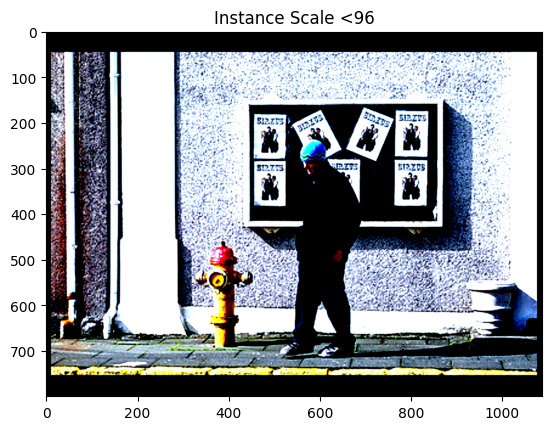

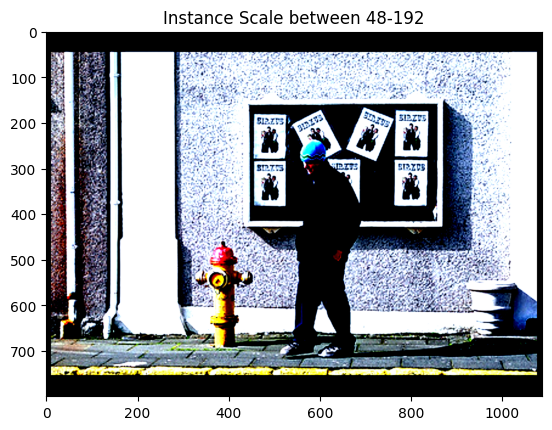

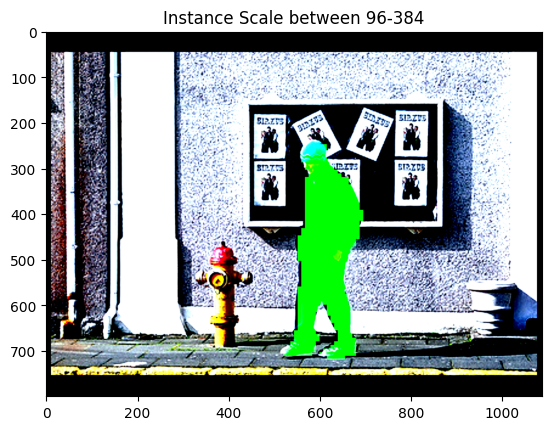

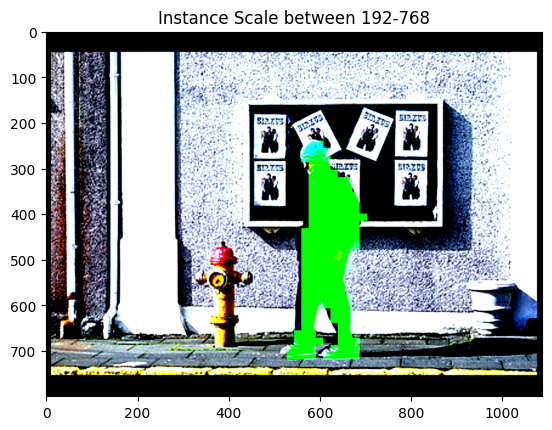

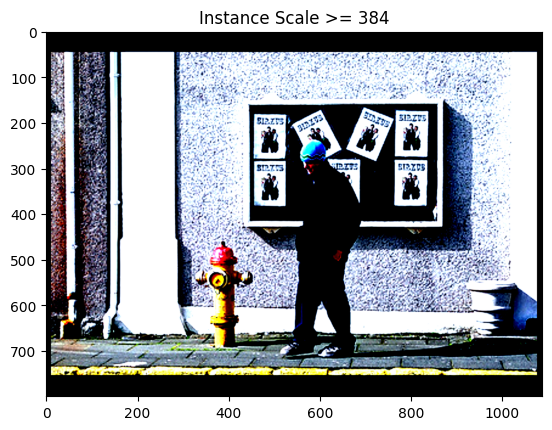

...

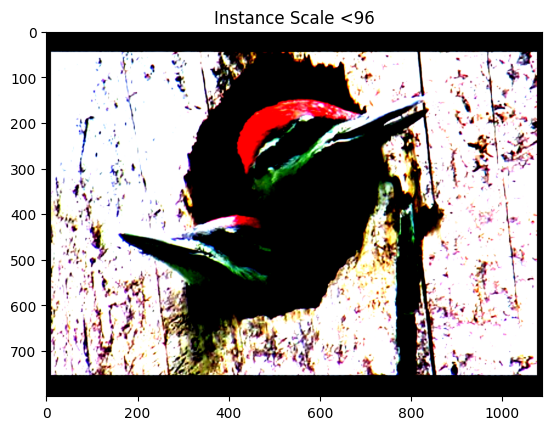

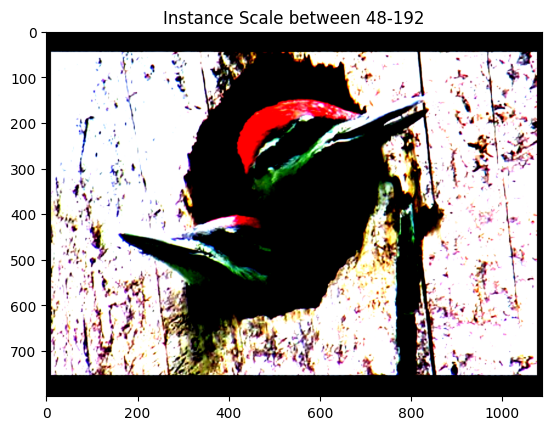

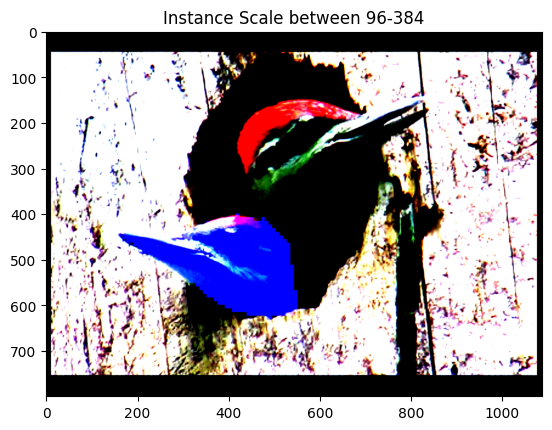

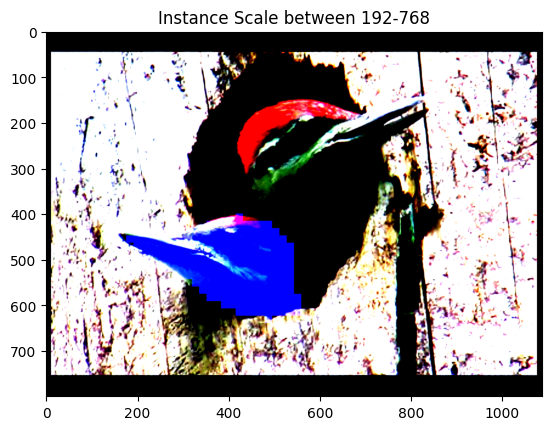

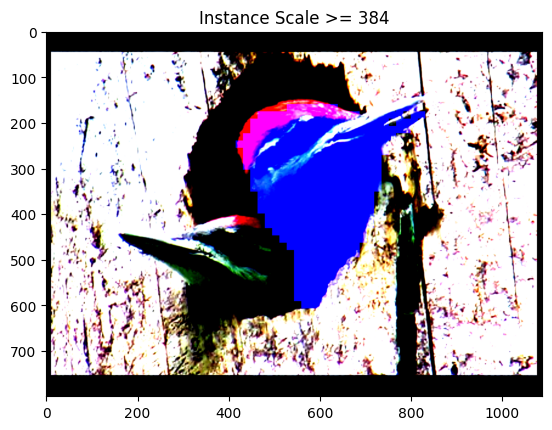

In [17]:
def plots(masks,labels,active_mask,img):
    for i in range(len(masks)):
      for j in range(len(masks[i])):
          #print(labels[i][j].shape)
          idx = torch.nonzero(labels[i][j] > 0,as_tuple=False)
          mask_idx =  torch.nonzero(active_mask[i][j] > 0,as_tuple=False).flatten().tolist()
          #print(idx)
          #print("FPN Level", j)
          if (len(idx) == 0):
            plot=img[i].numpy()
            plot= np.moveaxis(plot,0,-1)
            plt.figure()
            plt.imshow(plot)
            if j==0:
              plt.title("Instance Scale <96")
            if j==1:
              plt.title("Instance Scale between 48-192")
            if j==2:
              plt.title("Instance Scale between 96-384")
            if j==3:
              plt.title("Instance Scale between 192-768")
            if j==4:
              plt.title("Instance Scale >= 384")
            plt.show()
            continue
          #print(idx.shape)
          #print(mask_idx)
          mask = masks[i][j][mask_idx].unsqueeze(0)

          mask_resize = F.interpolate(mask, size=(img.shape[-2],img.shape[-1]), mode='nearest')
          #print(mask.shape)
          label = labels[i][j][labels[i][j]>0]
          #print(label)
          plt.figure()
          n = label.shape[0]
          #print(n)
          mask_resize = mask_resize.squeeze(0)
          #print(mask_resize.shape)
          img2 = img.squeeze(0).numpy().copy()
          img2= np.moveaxis(img2,0,-1)
          for k in range(n):
            c = label[k]
            mask2 = mask_resize[k]
            #print(mask2.shape)
            if (c == 1):
              img2[mask2 == 1,0] = 1
            if (c == 2):
              img2[mask2 == 1,1] = 1
            if (c == 3):
              img2[mask2 == 1,2] = 1

          plt.imshow(np.clip(img2,0,1))
          if j==0:
            plt.title("Instance Scale <96")
          if j==1:
            plt.title("Instance Scale between 48-192")
          if j==2:
            plt.title("Instance Scale between 96-384")
          if j==3:
            plt.title("Instance Scale between 192-768")
          if j==4:
            plt.title("Instance Scale >= 384")
          plt.show()

def visualise_targets(images, labels, masks, bboxes ):
  model = SOLO()

  for img,lbl,msk,bbx in zip(images, labels, masks, bboxes):
    img = img.unsqueeze(dim  = 0)
    lbl = [lbl]
    msk = [msk]
    bbx = [bbx]
    cat_targets,mask_targets,active_mask = model.generate_targets(bbx, lbl, msk)
    #print(len(cat_targets))
    plots(mask_targets,cat_targets,active_mask,img)


dataloader = DataLoader(image_ds, batch_size=5,shuffle=True, collate_fn=collate_fn)
images, labels, masks, bboxes = next(iter(dataloader))
visualise_targets(images, labels, masks, bboxes)

### Part A Submission
In addition to the code you used, you should submit a pdf containing the following plots:
* Dataset visualization plots such as fig. 5 and 6. You should include at least five examples and at least two examples that contain multiple objects. Additionally, the images should cover a range of scales and object classes.
* Target assignment plots such as fig. 8 and 9. Should include at least five examples and at least two examples that contain multiple objects. Additionally, the images should cover a range of scales and object classes.

We should be able to reproduce your results with a single function call or cell evaluation. Please specify the method to do so.

# **Code segments to produce visualisations**

Run the following Cells in order to obtain results

Note: Since we shuffle through the data the obtained images in th eoutput would be different. This was done to ensure that we were able to capture multi-object instances.

In [23]:
# download data, you can maunally download dataset set here:
# https://drive.google.com/drive/folders/1eP7FtPaWfJ5zLdcsZYl6eyn5EYixkFn8

!gdown --id 1JD3OaHpq_4KCb7ofcPMkknmdEXFHrCcn
!gdown --id 1ssRA7yijGLFmJU-ac-lPyUOq7DYzTAS1
!gdown --id 1Rpz-ZuQxDwvLyzc0FD9GZxAKlyka3VC5
!gdown --id 1ouMFNT1thia8l6P5vcWCY-nweAexLDsB
%pip install pytorch-lightning

/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1JD3OaHpq_4KCb7ofcPMkknmdEXFHrCcn
To: /content/hw3_mycocodata_mask_comp_zlib.h5
100% 4.30M/4.30M [00:00<00:00, 27.9MB/s]
/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1ssRA7yijGLFmJU-ac-lPyUOq7DYzTAS1
To: /content/hw3_mycocodata_labels_comp_zlib.npy
100% 269k/269k [00:00<00:00, 3.82MB/s]
/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downl

In [19]:
#Basic Initialization

#Code:
 #setting path in colab
 #mount the drive first
#click on the URL and copy the code. paste it in the box and press enter
import os

#set the working directory

root_dir = "/content/"

#choose the project folder
project_folder = ""

#define a function to create and set the working directory
def create_and_set_working_directory(project_folder):
  #check if the project folder exists. if not, make one.
  if os.path.isdir(root_dir + project_folder) == False:
    os.mkdir(root_dir + project_folder)
    print(root_dir + project_folder + 'did not existed and was created.')

  #change the OS path to project folder as working directory
  os.chdir(root_dir + project_folder)

  #create a test file in the working directory and see if it shows up at the right place
  !touch 'new_file_test.txt'
  print('working directory' + root_dir + project_folder + \
        "empty text file created. You can also run !pwd command to confirm working directory.")

create_and_set_working_directory(project_folder)

working directory/content/empty text file created. You can also run !pwd command to confirm working directory.


In [20]:
# images:         (batch_size, 3, 800, 1088)
# labels:         list with len: batch_size, each (n_obj,)
# masks:          list with len: batch_size, each (n_obj, 800,1088)
# bounding_boxes: list with len: batch_size, each (n_obj, 4)
import os
import numpy as np
import torch
import torchvision
from torchvision import transforms, datasets
from torch import nn, optim
from matplotlib import pyplot as plt
from torch.utils import data
from torch.utils.data import DataLoader
import torch.nn.functional as F
import pytorch_lightning as pl
import pytorch_lightning.loggers as pl_loggers
import pytorch_lightning.callbacks as pl_callbacks

import pickle
import h5py
#import helpers

import cv2
from PIL import Image
from pathlib import Path
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from sklearn.model_selection import train_test_split
import xml.etree.ElementTree as ET

In [21]:
class SOLODataset(data.Dataset):
  def __init__ (self, path):
    self.masks = h5py.File(path[0])['data']
    self.img = h5py.File(path[1])['data']
    self.lab = np.array(np.load(path[2], allow_pickle=True))
    self.bbox =  np.array(np.load(path[3],allow_pickle=True))

    self.transform = transforms.Compose([
         transforms.Resize((800, 1066)),
         transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
         transforms.Pad((11,0))])
    self.transform_mask = transforms.Compose([
         transforms.Resize((800, 1066)),
         transforms.Pad((11,0))])
    # self.transform = transforms.Compose([
    #   transforms.Pad((0,11)),
    #   transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
    #   transforms.Resize((800, 1066)),
    #   transforms.ToTensor()])
  def __len__(self):
        return len(self.img)

  def __getitem__(self, idx):
    mask_numb = 0
    mask_numb_end = 0

    for i in range(idx):
        mask_numb+=len(self.lab[i])
    #print(len(labels[idx]))
    mask_numb_end = mask_numb + len(self.lab[idx])

    img = self.transform(torch.tensor(self.img[idx]/255,dtype=torch.float32))
    masks = self.transform_mask(torch.tensor(self.masks[mask_numb:mask_numb_end]/1.0,dtype=torch.int32))
    bbox = self.bbox[idx]*2.667# Rescaling the bounding boxes
    bbox[:,[1,3]] += 11
    sample = img,self.lab[idx],masks,bbox

    return sample

def collate_fn(batch):
  image_list =[]
  label_list = []
  masks_list = []
  bounding_boxes_list = []

  for images,labels,masks,boxes in batch:
    image_list.append(images)
    label_list.append(labels)
    masks_list.append(masks)
    bounding_boxes_list.append(boxes)

  return torch.stack(image_list,dim = 0), label_list, masks_list, bounding_boxes_list

Visualisations for Target Assignment
Labels
1


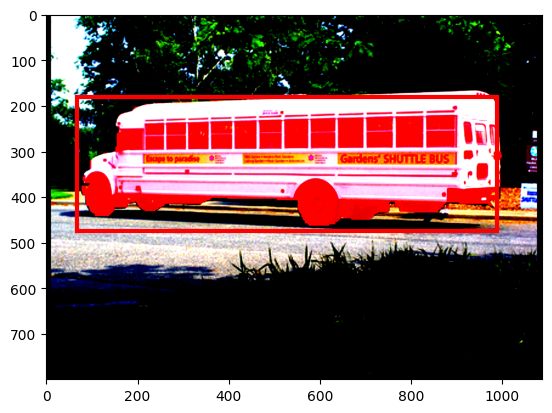

1


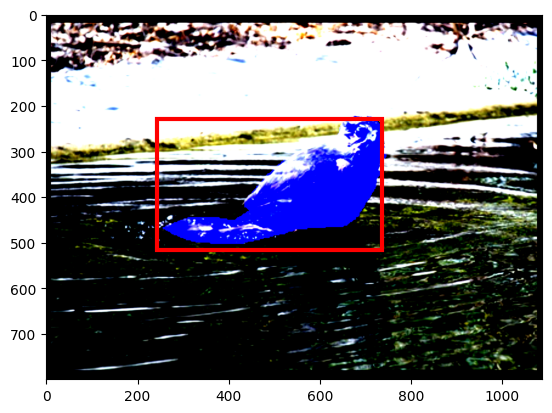

1


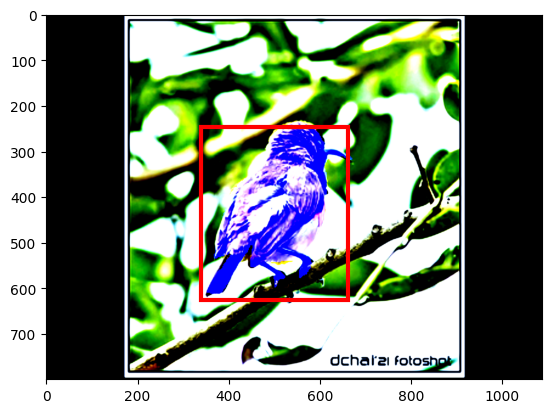

1


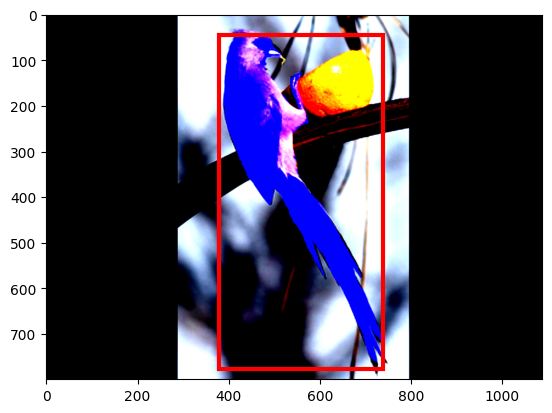

1


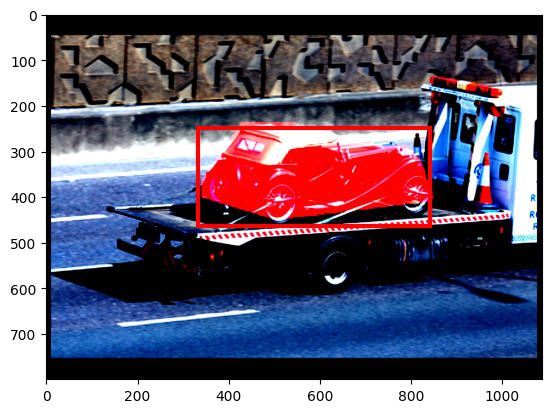

1


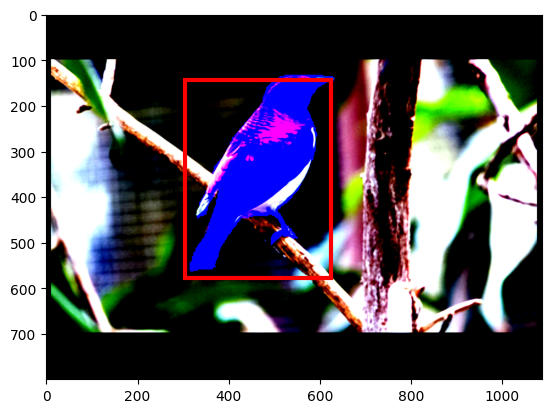

1


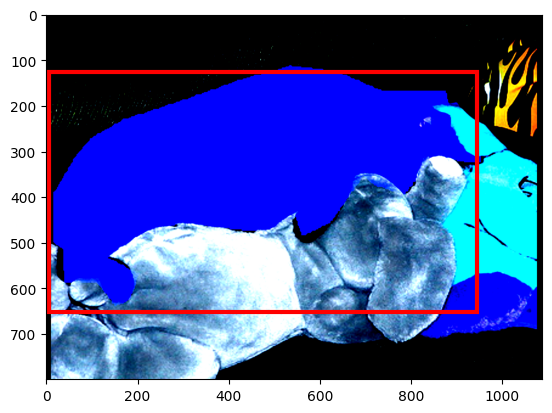

1


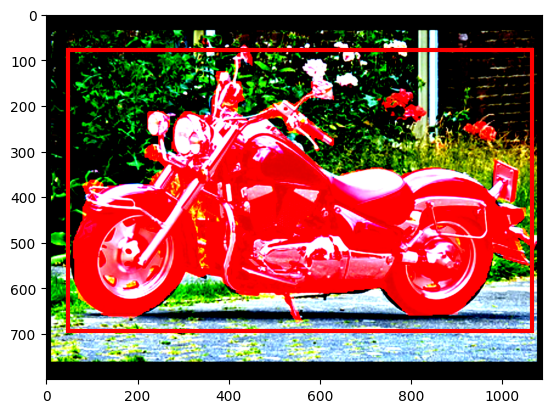

1


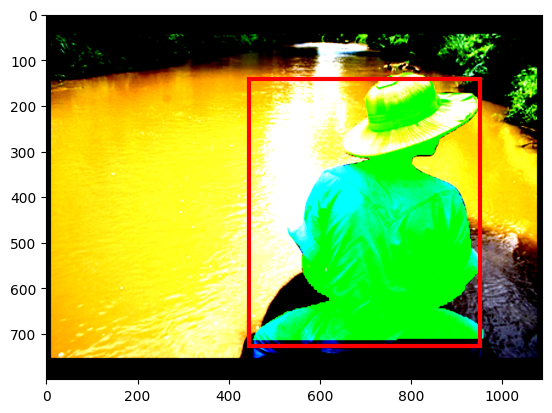

1


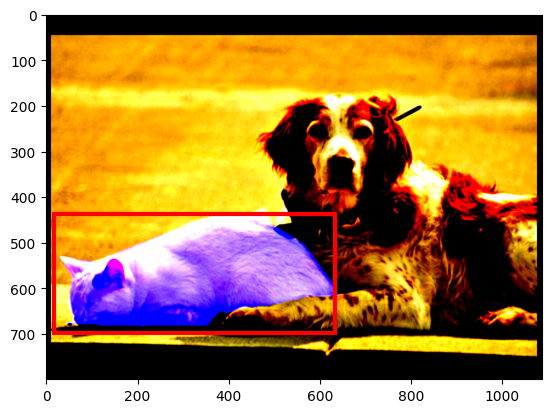

Target Assignment


<ipython-input-12-94b7db998450>:318: DeprecationWarning: Please use `center_of_mass` from the `scipy.ndimage` namespace, the `scipy.ndimage.measurements` namespace is deprecated.
  cx,cy = ndimage.measurements.center_of_mass(masks[i][k].cpu().detach().numpy().astype(int))


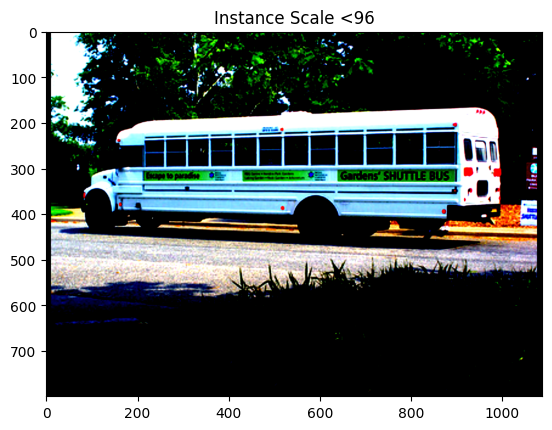

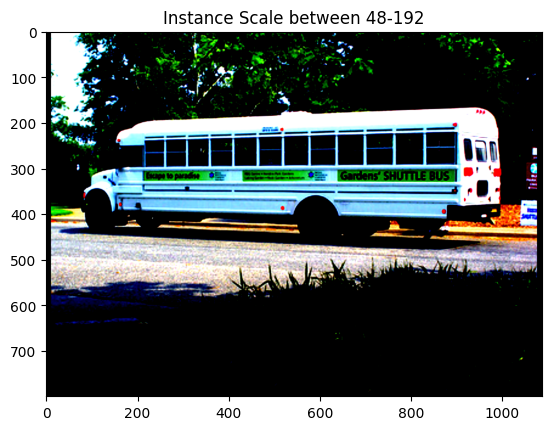

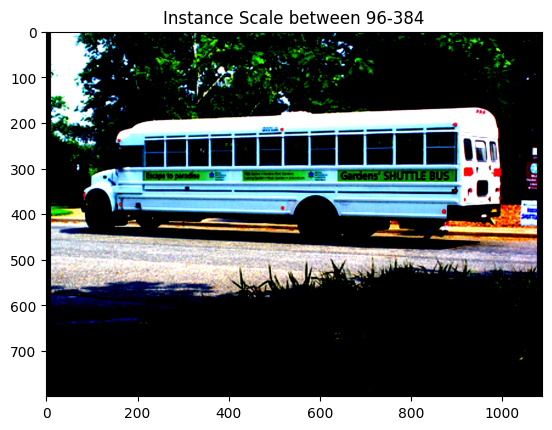

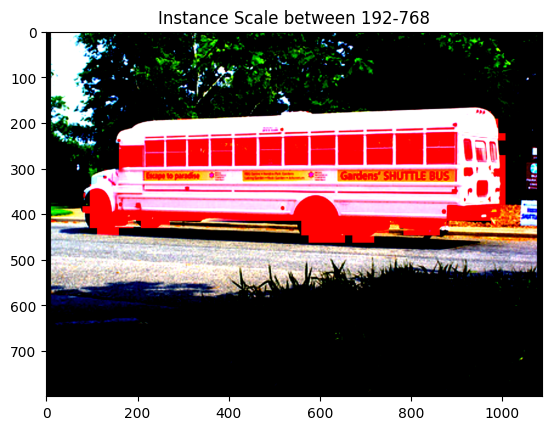

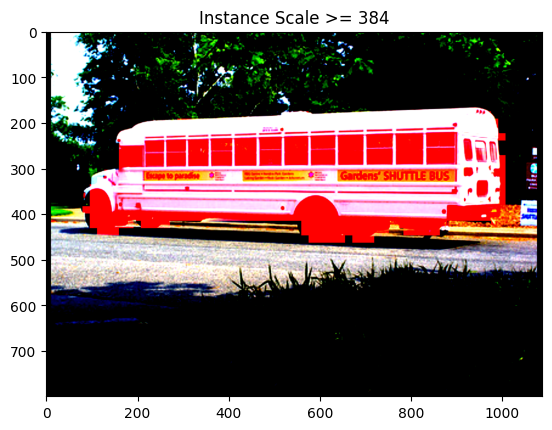

...

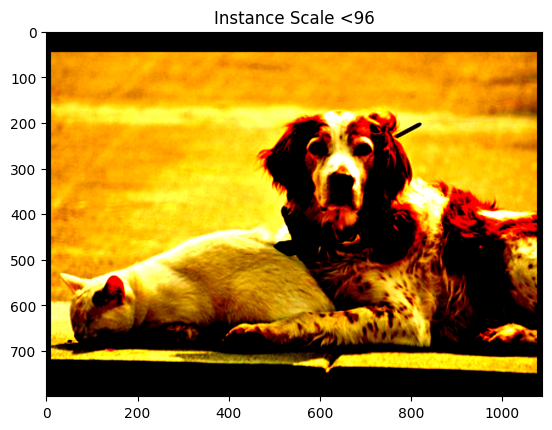

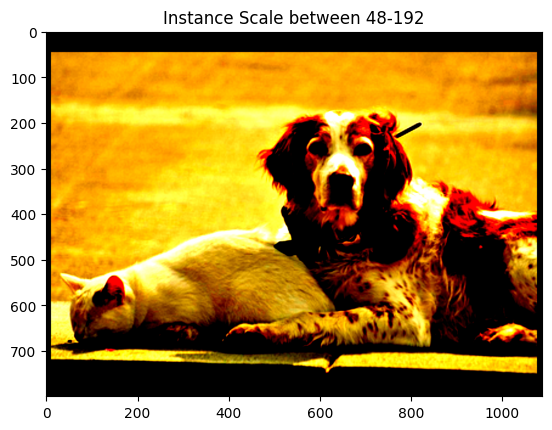

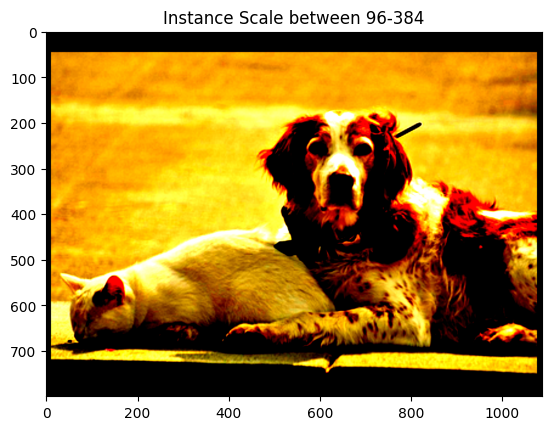

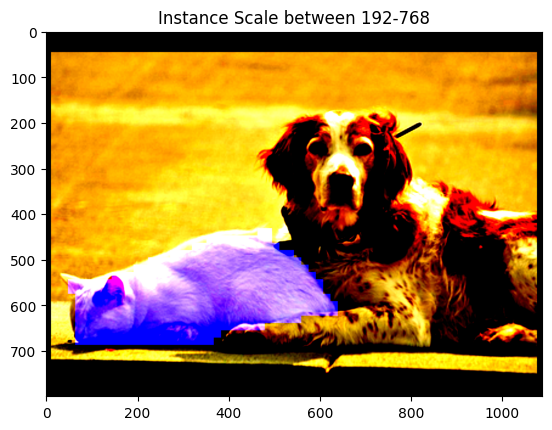

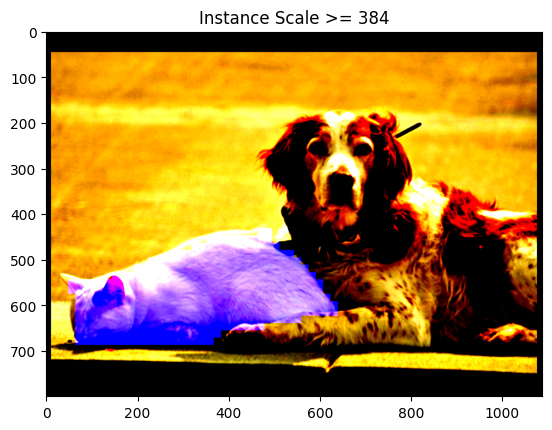

In [22]:

paths = ['/content/hw3_mycocodata_mask_comp_zlib.h5','/content/hw3_mycocodata_img_comp_zlib.h5','/content/hw3_mycocodata_labels_comp_zlib.npy','/content/hw3_mycocodata_bboxes_comp_zlib.npy']
image_ds = SOLODataset(paths)

print ("Visualisations for Target Assignment")
dataloader = DataLoader(image_ds, batch_size=10,shuffle=True, collate_fn=collate_fn)
images, labels, masks, bboxes = next(iter(dataloader))
print('Labels')
visualise_labels(images.clone(), labels.copy(), masks.copy(), bboxes.copy() )

print('Target Assignment')
visualise_targets(images, labels, masks, bboxes )

## Part B

In [ ]:
# download data, you can maunally download dataset set here:
# https://drive.google.com/drive/folders/1eP7FtPaWfJ5zLdcsZYl6eyn5EYixkFn8

!gdown --id 1JD3OaHpq_4KCb7ofcPMkknmdEXFHrCcn
!gdown --id 1ssRA7yijGLFmJU-ac-lPyUOq7DYzTAS1
!gdown --id 1Rpz-ZuQxDwvLyzc0FD9GZxAKlyka3VC5
!gdown --id 1ouMFNT1thia8l6P5vcWCY-nweAexLDsB
!gdown --id 1Xyo9voEtL8fFf0gh7NY8L0cC6z8mZDrl

/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1JD3OaHpq_4KCb7ofcPMkknmdEXFHrCcn
To: /content/hw3_mycocodata_mask_comp_zlib.h5
100% 4.30M/4.30M [00:00<00:00, 29.5MB/s]
/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1ssRA7yijGLFmJU-ac-lPyUOq7DYzTAS1
To: /content/hw3_mycocodata_labels_comp_zlib.npy
100% 269k/269k [00:00<00:00, 4.99MB/s]
/usr/local/lib/python3.10/dist-packages/gdown/cli.py:121: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downl

In [ ]:
!pip install pytorch-lightning
!pip install torchtext
!pip install tensorboardX

In [ ]:
import os
import numpy as np
from scipy import ndimage

import torch
import torchvision
from torchvision import transforms, datasets
from torch import nn, optim
from matplotlib import pyplot as plt
from torch.utils import data
from torch.utils.data import DataLoader
import torch.nn.functional as F
import pytorch_lightning as pl
import pytorch_lightning.loggers as pl_loggers
import pytorch_lightning.callbacks as pl_callbacks

import pickle
import h5py

import cv2
from PIL import Image
from pathlib import Path
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from sklearn.model_selection import train_test_split
from sklearn.metrics import auc
import xml.etree.ElementTree as ET

import numpy as np
import torch
from solo_head import *
from backbone import *
from dataset import *
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data
from tensorboardX import SummaryWriter
import os.path
import gc
gc.enable()device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

root_dir = "/content/"

In [ ]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print("device = ", device)

device =  cuda:0


In [ ]:
paths = ['hw3_mycocodata_img_comp_zlib.h5',
         'hw3_mycocodata_mask_comp_zlib.h5',
         'hw3_mycocodata_labels_comp_zlib.npy',
         'hw3_mycocodata_bboxes_comp_zlib.npy']

dataset = BuildDataset(paths)
del paths

In [ ]:
train_size = int(len(dataset) * 0.8)
test_size = len(dataset) - train_size

torch.random.manual_seed(1)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
np.random.seed(0)

train_dataset, test_dataset = torch.utils.data.random_split(
    dataset, [train_size, test_size])

batch_size = 2
train_build_loader = BuildDataLoader(
    train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
train_loader = train_build_loader.loader()
test_build_loader = BuildDataLoader(
    test_dataset, batch_size=batch_size, shuffle=False, num_workers=0)
test_loader = test_build_loader.loader()

In [ ]:
resnet50_fpn = Resnet50Backbone()
solo_head = SOLOHead(num_classes=4)

resnet50_fpn = resnet50_fpn.to(device)
resnet50_fpn.eval()
solo_head = solo_head.to(device)

num_epochs = 10
optimizer = optim.SGD(solo_head.parameters(), lr=0.01 /
                      16*batch_size, momentum=0.9, weight_decay=0.0001)
scheduler = optim.lr_scheduler.MultiStepLR(
    optimizer, milestones=[27, 33], gamma=0.1)

In [ ]:
os.makedirs("logs", exist_ok=True)
writer = SummaryWriter(log_dir="logs")

os.makedirs("train_checkpt", exist_ok=True)

In [ ]:
# Train
train_losses = {"cate": [], "mask": [], "total": []}
test_losses = {"cate": [], "mask": [], "total": []}

for epoch in range(num_epochs):
    solo_head.train()
    cum_losses = {"cate": 0.0, "mask": 0.0, "total": 0.0}

    for iter, data in enumerate(train_loader):
        img, label_list, mask_list, bbox_list = data
        img, label_list, mask_list, bbox_list = img.to(device), [x.to(device) for x in label_list], [x.to(device) for x in mask_list], [x.to(device) for x in bbox_list]

        with torch.no_grad():
            backout = resnet50_fpn(img)

        fpn_feat_list = list(backout.values())
        optimizer.zero_grad()
        cate_pred_list, ins_pred_list = solo_head.forward(fpn_feat_list, eval=False)

        ins_gts_list, ins_ind_gts_list, cate_gts_list = solo_head.target(ins_pred_list, bbox_list, label_list, mask_list)
        cate_loss, mask_loss, total_loss = solo_head.loss(cate_pred_list, ins_pred_list, ins_gts_list, ins_ind_gts_list, cate_gts_list)

        total_loss.backward()
        optimizer.step()
        cum_losses["cate"] += cate_loss.item()
        cum_losses["mask"] += mask_loss.item()
        cum_losses["total"] += total_loss.item()

        if np.isnan(cum_losses["total"]):
            raise RuntimeError(f"[ERROR] NaN encountered - iter {iter}")

        if iter % 100 == 99:
            log_losses = {key: cum_losses[key] / 100.0 for key in cum_losses}
            for loss_type in ["cate", "mask", "total"]:
                writer.add_scalar(f'Loss/train/log_{loss_type}_loss', log_losses[loss_type], len(train_losses[loss_type]))
                train_losses[loss_type].append(log_losses[loss_type])
            print(f'\nIteration:{iter+1} Avg. train total loss: {log_losses["total"]:.4f}')
            cum_losses = {key: 0.0 for key in cum_losses}

    path = f'./train_checkpt/solo_epoch_{epoch}'
    torch.save({
        'epoch': epoch,
        'model_state_dict': solo_head.state_dict(),
        'optimizer_state_dict': optimizer.state_dict()
    }, path)

    # Validation
    solo_head.eval()
    test_cum_losses = {"cate": 0.0, "mask": 0.0, "total": 0.0}

    with torch.no_grad():
        for iter, data in enumerate(test_loader):
            img, label_list, mask_list, bbox_list = data
            img, label_list, mask_list, bbox_list = img.to(device), [x.to(device) for x in label_list], [x.to(device) for x in mask_list], [x.to(device) for x in bbox_list]

            backout = resnet50_fpn(img)
            fpn_feat_list = list(backout.values())
            cate_pred_list, ins_pred_list = solo_head.forward(fpn_feat_list, eval=False)

            ins_gts_list, ins_ind_gts_list, cate_gts_list = solo_head.target(ins_pred_list, bbox_list, label_list, mask_list)
            cate_loss, mask_loss, total_loss = solo_head.loss(cate_pred_list, ins_pred_list, ins_gts_list, ins_ind_gts_list, cate_gts_list)
            test_cum_losses["cate"] += cate_loss.item()
            test_cum_losses["mask"] += mask_loss.item()
            test_cum_losses["total"] += total_loss.item()

        epoch_losses = {key: test_cum_losses[key] / len(test_loader.dataset) for key in test_cum_losses}
        print(f'\nEpoch:{epoch + 1} Avg. test loss: {epoch_losses["total"]:.4f}')

        for loss_type in ["cate", "mask", "total"]:
            writer.add_scalar(f'Loss/test/{loss_type}_loss', epoch_losses[loss_type], epoch)
            test_losses[loss_type].append(epoch_losses[loss_type])

    scheduler.step()

writer.close()


In [ ]:
# Inference


class ModelEvaluator:
    def __init__(self, tracker_id):
        self.reset()
        self.tracker_id = tracker_id

    def reset(self):
        self.conf_scores = np.zeros((0,))
        self.tp_indicator = np.zeros((0,), np.bool_)
        self.match_idx = np.zeros((0,), np.int32)
        self.num_gts = 0
        self.precision_recall = dict()

    def copy(self):
        copy_instance = ModelEvaluator(self.tracker_id)
        copy_instance.conf_scores = self.conf_scores.copy()
        copy_instance.tp_indicator = self.tp_indicator.copy()
        copy_instance.match_idx = self.match_idx.copy()
        copy_instance.num_gts = self.num_gts
        copy_instance.precision_recall = self.precision_recall.copy()

        return copy_instance

    def update_metrics(self, conf_scores, tp_indicator, match_idx, num_gt_batch):
        conf_scores = conf_scores.detach().cpu().numpy() if isinstance(conf_scores, torch.Tensor) else conf_scores
        tp_indicator = tp_indicator.detach().cpu().numpy() if isinstance(tp_indicator, torch.Tensor) else tp_indicator
        match_idx = match_idx.detach().cpu().numpy() if isinstance(match_idx, torch.Tensor) else match_idx

        assert isinstance(conf_scores, np.ndarray)
        assert isinstance(tp_indicator, np.ndarray)
        assert isinstance(match_idx, np.ndarray)
        assert len(conf_scores) == len(tp_indicator)
        assert len(match_idx) == len(tp_indicator)

        if len(match_idx) == 0:
            self.num_gts += num_gt_batch
            return

        if num_gt_batch == 0:
            assert np.all(tp_indicator == False)
        else:
            assert np.max(match_idx) < num_gt_batch

        self.conf_scores = np.concatenate([self.conf_scores, conf_scores])
        self.tp_indicator = np.concatenate([self.tp_indicator, tp_indicator])
        match_idx_new = match_idx + self.num_gts

        if self.tracker_id == 0:
            debug = True

        self.match_idx = np.concatenate([self.match_idx, match_idx_new])
        self.num_gts += num_gt_batch

        for i in range(match_idx_new.shape[0]):
            if tp_indicator[i] and (match_idx_new[i] >= self.num_gts):
                raise RuntimeError("Check Failed")

    def compute(self):
        precision_recall = {}
        n_tp, n_tot_pred, num_gts = 0.0, 0.0, self.num_gts

        sorted_idx = np.argsort(self.conf_scores)
        sorted_scores, sorted_tp_indicator, sorted_match_idx = self.conf_scores[sorted_idx], self.tp_indicator[sorted_idx], self.match_idx[sorted_idx]

        for score, is_tp, match_idx in zip(sorted_scores, sorted_tp_indicator, sorted_match_idx):
            n_tot_pred += 1
            if is_tp:
                n_tp += 1
            precision = n_tp / n_tot_pred
            recall = np.sum(sorted_tp_indicator[:n_tot_pred]) / num_gts
            precision_recall[recall] = precision

        self.precision_recall = precision_recall

        del sorted_scores, sorted_tp_indicator, sorted_match_idx
        return precision_recall


    def sort_curve(self):
        assert len(self.precision_recall) != 0, "[ERROR] Please compute precision and recall before calling sort_curve"
        recall_sorted = sorted(list(self.precision_recall.keys()))
        precision_sorted = [self.precision_recall[k] for k in recall_sorted]
        return recall_sorted, precision_sorted

    def compute_average_precision(self):
        assert len(self.precision_recall) != 0, "[ERROR] Please compute precision and recall before calling compute_average_precision"
        recall_sorted = sorted(list(self.precision_recall.keys()))
        precision_sorted = [self.precision_recall[k] for k in recall_sorted]
        if len(recall_sorted) > 1:
            return auc(recall_sorted, precision_sorted)
        else:
            return 0.0

os.makedirs("output", exist_ok=True)
os.makedirs("infer_result", exist_ok=True)

eval_epoch = 20
VISUALIZATION = True
batch_size = 2
cate_thresh = 0.33

resnet50_fpn = Resnet50Backbone()
solo_head = SOLOHead(num_classes=4)

solo_head.postprocess_cfg['cate_thresh'] = cate_thresh
print(f"[INFO] Category Threshold: {cate_thresh}")

print(f"[INFO] eval epoch: {eval_epoch}")
checkpoint_file = f"./train_checkpt/solo_epoch_{eval_epoch}"
checkpoint = torch.load(checkpoint_file)
print("[INFO] Loaded checkpoint file successfully")
solo_head.load_state_dict(checkpoint['model_state_dict'])

solo_head = solo_head.to(device)
solo_head.eval()

color_list = ["jet", "ocean", "Spectral"]

model_evals = []
for i in range(solo_head.num_classes - 1):
    model_evals.append(ModelEvaluator(i))

with torch.no_grad():
    for iter, data in enumerate(tqdm(test_loader), 0):
        img, label_list, mask_list, bbox_list = [
            data[i] for i in range(len(data))]
        img = img.to(device)
        label_list = [x.to(device) for x in label_list]
        mask_list = [x.to(device) for x in mask_list]
        bbox_list = [x.to(device) for x in bbox_list]

        backout = resnet50_fpn(img)
        fpn_feat_list = list(backout.values())
        cate_pred_list, ins_pred_list = solo_head.forward(
            fpn_feat_list, eval=True)

        NMS_sorted_scores_list, NMS_sorted_cate_label_list, NMS_sorted_ins_list = solo_head.PostProcess(
            ins_pred_list, cate_pred_list, (img.shape[2], img.shape[3]))
        del ins_pred_list
        del cate_pred_list
        if (VISUALIZATION):
            solo_head.PlotInfer(NMS_sorted_scores_list, NMS_sorted_cate_label_list, NMS_sorted_ins_list,
                                color_list, img, iter)

        for sorted_scores, sorted_cate_label, sorted_ins, label_gt, mask_gt in zip(NMS_sorted_scores_list,
                                                                                   NMS_sorted_cate_label_list,
                                                                                   NMS_sorted_ins_list, label_list,
                                                                                   mask_list):
            assert torch.all(sorted_cate_label != 0)
            for label_x in range(solo_head.num_classes):
                if (label_x == 0):
                    continue
                idx_gt = (label_gt == label_x)
                idx_pred = (sorted_cate_label == label_x)

                N_gt = torch.sum(idx_gt).item()
                N_pred = torch.sum(idx_pred).item()
                if N_gt == 0:
                    if N_pred == 0:
                        continue
                    conf_scores = sorted_scores[idx_pred]
                    tp_indicator = np.zeros((N_pred, ), dtype=np.bool_)
                    match_idx = np.zeros((N_pred, ), dtype=np.int32)
                else:
                    if N_pred != 0:
                        conf_scores = sorted_scores[idx_pred]
                        cate_label = sorted_cate_label[idx_pred]
                        ins_pred = sorted_ins[idx_pred]
                        assert len(ins_pred) == N_pred

                        ins_gt = mask_gt[idx_gt]

                        ious = solo_head.MatrixIOU(ins_pred > solo_head.postprocess_cfg['ins_thresh'],
                                                   ins_gt > solo_head.postprocess_cfg['ins_thresh'])
                        assert ious.shape == (N_pred, N_gt)
                        max_ious, iou_max_idx = torch.max(ious, dim=1)
                        assert max_ious.shape[0] == N_pred
                        assert iou_max_idx.shape[0] == N_pred

                        tp_indicator = (
                            max_ious > solo_head.postprocess_cfg['IoU_thresh'])
                        match_idx = iou_max_idx
                    else:
                        conf_scores = torch.zeros((0,))
                        tp_indicator = torch.zeros((0,), dtype=torch.bool)
                        match_idx = torch.zeros((0,), dtype=torch.int)

                tmp = model_evals[label_x - 1]
                if isinstance(tmp, ModelEvaluator):
                    tmp.update_metrics(conf_scores, tp_indicator,
                                  match_idx, N_gt)
                    model_evals[label_x - 1] = tmp.copy()
                else:
                    print("tmp is not of type ModelEvaluator")

        output_filename = os.path.join("output", f"results_iter_{iter}.txt")
        with open(output_filename, 'w') as output_file:
            output_file.write(f"Results of iter {iter}\n")
            for i in range(solo_head.num_classes - 1):
                tmp = model_evals[i]
                if isinstance(tmp, ModelEvaluator):
                    tmp.compute()
                    if not tmp.precision_recall:
                        continue
                    recall, precision = tmp.sort_curve()
                    average_precision = tmp.compute_average_precision()
                    output_file.write(f"class_id: {i}. average_precision: {average_precision}\n")
                    tmp.reset()
                else:
                    print("tmp is not of type ModelEvaluator")

    fig, ax = plt.subplots(1)
    for i in range(solo_head.num_classes - 1):
        tmp = model_evals[i]
        if isinstance(tmp, ModelEvaluator):
            tmp.compute()
            recall, precision = tmp.sort_curve()

            plt.plot(recall, precision)

            average_precision = tmp.compute_average_precision()
            print(f"class_id: {i}. average_precision: {average_precision}")
            tmp.reset()

        else:
            print("tmp is not of type ModelEvaluator")


In [ ]:
import matplotlib.pyplot as plt

# Plot training losses
plt.figure(figsize=(10, 6))
plt.plot(train_losses["total"], label="Train Total Loss")
plt.plot(train_losses["cate"], label="Train Category Loss")
plt.plot(train_losses["mask"], label="Train Mask Loss")
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Losses')
plt.legend()
plt.show()

# Plot validation losses
plt.figure(figsize=(10, 6))
plt.plot(val_losses["total"], label="Validation Total Loss")
plt.plot(val_losses["cate"], label="Validation Category Loss")
plt.plot(val_losses["mask"], label="Validation Mask Loss")
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Validation Losses')
plt.legend()
plt.show()
